In [8]:
#import all packages
# Native libraries
import os
import math
# Essential Libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
# Preprocessing
from sklearn.preprocessing import MinMaxScaler
# Algorithms
from minisom import MiniSom
from tslearn.barycenters import dtw_barycenter_averaging
from sklearn.cluster import KMeans
from tslearn.clustering import TimeSeriesKMeans, silhouette_score
from tslearn.utils import to_time_series_dataset
from tslearn.metrics import dtw, cdist_dtw

from sklearn.decomposition import PCA
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.express as px
import matplotlib.pyplot as plt
import random

## Read Data

In [9]:
path = 'C:/Users/somrock/Danaher_digital/data/raw/'

temp = []
temp1 = []
for filename in os.listdir(path):
    if filename.endswith(".csv"):
        df = pd.read_csv(path+filename)
        df=df.loc[0:31720]
        df = df.loc[:,["var19","var24","var23","var21","var17","var14","label"]]
        df.sort_index(inplace=True)
        temp.append(df)
        temp1.append(filename[:-4])

In [10]:
display(temp)

[          var19     var24     var23     var21     var17     var14  label
 0     -0.042127  0.343222 -0.016464 -0.050161  0.490546  0.065315    1.0
 1     -0.025505  1.227522  0.112784 -0.011609  0.362937  0.050271    1.0
 2     -0.043420  1.853889  0.016130  0.154549  0.488855 -0.022845    1.0
 3     -0.006468  1.900751  0.808031 -0.006452  0.307249 -0.029239    1.0
 4     -0.049918  1.509060 -0.019464  0.074557 -0.026971  0.032111    1.0
 ...         ...       ...       ...       ...       ...       ...    ...
 31716  1.432347 -0.016534  0.389503 -0.031912  2.178695 -0.020972   14.0
 31717  1.639063 -0.036985 -0.045311  0.071127  1.651417 -0.017870   14.0
 31718  1.637975 -0.020169 -0.035501  0.064389  2.626539 -0.030173   14.0
 31719  1.455129 -0.049737 -0.033189 -0.047487  2.413536 -0.015380   14.0
 31720  1.346523 -0.021585 -0.043949 -0.012096  1.625422 -0.049452   14.0
 
 [31721 rows x 7 columns],
           var19     var24     var23     var21     var17     var14  label
 0      0

In [11]:
#Missing data checked
#temp[12].isnull().sum().sum()
temp[6]

,var19,var24,var23,var21,var17,var14,label
0,-0.029346,0.409159,-0.154235,-0.010030,-0.121157,2.187235,21.0
1,1.251663,0.130338,0.131312,-0.080929,0.151615,-0.104160,12.0
2,0.100894,3.278638,0.045798,-0.027483,1.094492,0.172791,8.0
3,0.058405,0.805489,-0.067292,-0.042561,-0.129649,-0.149197,12.0
4,0.820335,-0.051128,-0.035904,-0.056049,-0.089520,-0.114313,12.0
...,...,...,...,...,...,...,...
31716,-0.110873,-0.075993,0.020433,0.358898,-0.009799,-0.156394,23.0
31717,0.917617,-0.039345,-0.155006,-0.073286,0.144497,-0.068584,12.0
31718,1.857462,-0.130426,-0.125025,-0.120300,-0.107481,0.478673,13.0
31719,-0.150219,3.000989,0.006409,-0.133222,0.130000,-0.067667,8.0


## Data Analysis

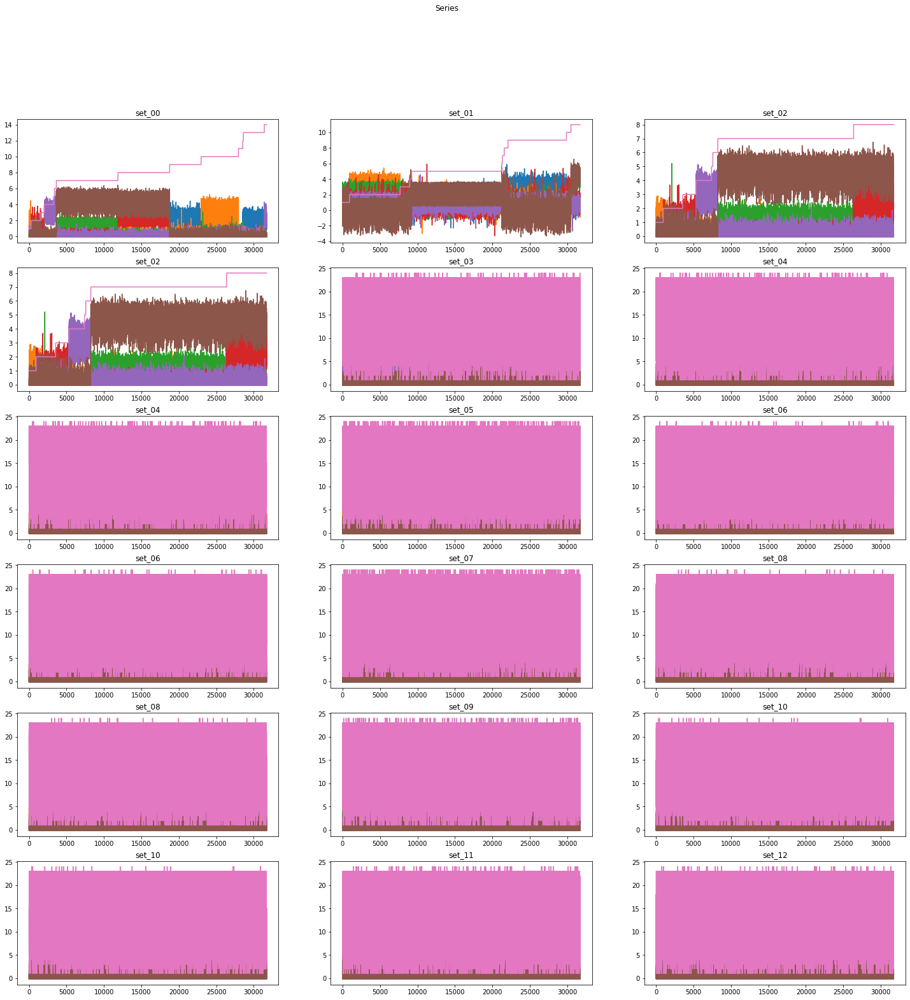

In [12]:
fig, axs = plt.subplots(6,3,figsize=(25,25))
fig.suptitle('Series')
for i in range(6):
    for j in range(3):
        if i*2+j+1>len(temp): # pass the others that we can't fill
            continue
        axs[i, j].plot(temp[i*2+j].values)
        axs[i, j].set_title(temp1[i*2+j])
plt.show()

In [13]:
leng = {len(series) for series in temp}
print(leng)

{31721}


In [14]:
max_len = max(leng)
longest_series = None
for series in temp:
    if len(series) == max_len:
        longest_series = series

In [15]:
problems_index = []

for i in range(len(temp)):
    if len(temp[i])!= max_len:
        problems_index.append(i)
        temp[i] = temp[i].reindex(longest_series.index)

## Creating dataframe with list

In [16]:
#data frame creation
df_new = pd.DataFrame()
for data in temp:
    df_new = pd.concat([df_new, pd.DataFrame(data["var19"].values, columns=[data['label'][0]], index=data.index)], axis=1)

## visualization of data label wise

In [19]:
x, y = 3, 2
fig = make_subplots(x,y,subplot_titles=tuple([str(i) for i in range(6)]))
selected_indices = random.sample(range(len(df_new.columns)), x*y)
idx=0
for i in range(1,x+1):
    for j in range(1,y+1):
        fig.add_trace(go.Scatter(x=df_new.iloc[:, selected_indices[idx]].index, y=df_new.iloc[:, selected_indices[idx]], name=df_new.columns[selected_indices[idx]]),i ,j)
        fig.layout.annotations[idx]['text'] = df_new.columns[selected_indices[idx]]
        idx+=1
fig.show()

In [20]:
#df_new.to_csv("ff.csv")
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler(df_new)


# fig = go.Figure()

# for company_name in df_new.columns:
#     df_new[label] = scaler.fit_transform(pd.DataFrame(df_new[label]))
#     fig.add_trace(go.Scatter(y=df_new[label],
#                     mode='lines',
#                     name=label))
# fig.show()

C:\Users\somrock\.conda\envs\pytorchgpu\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass copy=           1.0       1.0       1.0       22.0      15.0      8.0       21.0  \
0     -0.042127  0.525611 -0.006696 -0.123350  0.097267 -0.044924 -0.029346   
1     -0.025505  0.309583 -0.016654 -0.152852  1.872401  2.077181  1.251663   
2     -0.043420 -0.116073  0.073855  0.182187 -0.012438 -0.015571  0.100894   
3     -0.006468 -0.639139 -0.017661 -0.074423 -0.105742 -0.020726  0.058405   
4     -0.049918 -0.173889  0.080423 -0.148123  1.543044  0.040319  0.820335   
...         ...       ...       ...       ...       ...       ...       ...   
31716  1.432347 -0.419582  0.224493 -0.061968 -0.086161 -0.003820 -0.110873   
31717  1.639063 -0.166589  0.585917 -0.062899  0.145688  0.213358  0.917617   
31718  1.637975 -0.222155  0.086508 -0.024275  0.979092  1.574003  1.857462   
31719  1.455129 -0.273504  0.350495  1.090010  1.647836  0.082421 -0.150219   
31720  1.346523

In [21]:
from tslearn.clustering import TimeSeriesKMeans, silhouette_score
from tslearn.barycenters import dtw_barycenter_averaging
from tslearn.utils import to_time_series_dataset
from tslearn.metrics import dtw, cdist_dtw
df_new1 = to_time_series_dataset(df_new.values.T)

In [22]:
df_new1.shape

(13, 31721, 1)

In [23]:
scores = []
for k in range(1, 13):
    model = TimeSeriesKMeans(n_clusters=k, metric='euclidean', verbose=False, n_jobs=-1, n_init=15, random_state=0)
    model.fit(df_new1)
    scores.append(model.inertia_)
    print(f'Inertia value for {k}: {scores[-1]}')

Inertia value for 1: 16466.888181449947
Inertia value for 2: 11509.799586935684
Inertia value for 3: 9368.73352331775
Inertia value for 4: 8269.239292353148
Inertia value for 5: 7133.032326422817
Inertia value for 6: 6059.518686986292
Inertia value for 7: 5043.63283876758
Inertia value for 8: 4042.6853265524824
Inertia value for 9: 3098.283376870665
Inertia value for 10: 2174.429351338284
Inertia value for 11: 1273.868206823213
Inertia value for 12: 446.9883945721898


In [ ]:
Selecting the K value using kneed

k-value: 3


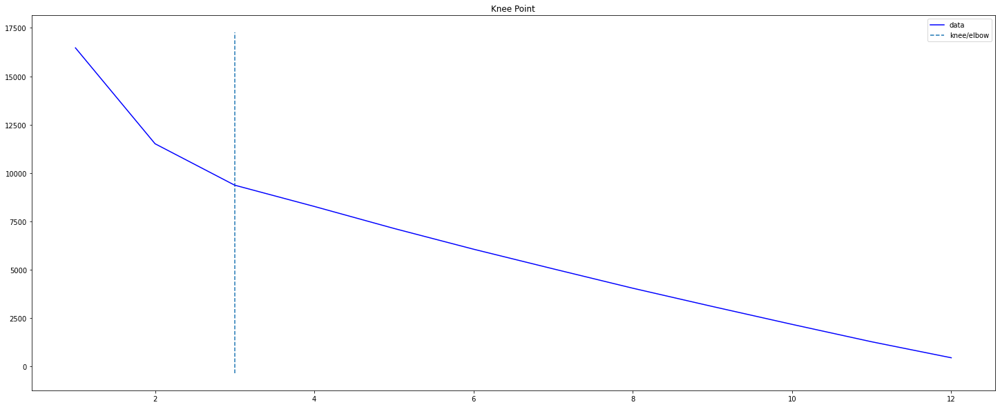

In [24]:
from kneed import KneeLocator
elbo = KneeLocator(range(1, len(scores)+1), scores, curve='convex', direction='decreasing', online=True)
elbo.plot_knee(figsize=(25,10))
print(f'k-value: {elbo.knee}')

## Diffrent matrix

In [27]:
#selecting k value from above method
euclidean_model = TimeSeriesKMeans(n_clusters=elbo.knee, metric='euclidean', verbose=True, n_jobs=-1, random_state=0)
euclidean_cluster_labels = euclidean_model.fit_predict(df_new1)

18838.354 --> 14411.333 --> 14411.333 --> 


## was trying with different matrics dtw but kernal died so many times

In [ ]:
Cluster points visualization

In [32]:
label_new = np.unique(euclidean_cluster_labels)
fig = go.Figure()
default_state = "Cluster 1"
cluster_plot_names = []
buttons = []
states = []
for idx in range(len(label_new)):
    for element_idx in np.argwhere(euclidean_cluster_labels == label_new[idx]):
        fig.add_trace(go.Scatter(x=df_new.iloc[:, element_idx].index, y=df_new.iloc[:, element_idx].values.flatten(), name=df_new.columns[element_idx][0], line=dict(color="gray"), opacity=0.4, visible=(f'Cluster {idx+1}'== default_state)))
    fig.add_trace(go.Scatter(x=df_new.iloc[:, element_idx].index, y=euclidean_model.cluster_centers_[label_new[idx]].flatten(), name=f'Cluster {idx+1} Center', line=dict(color="cyan"), visible=(f'Cluster {idx+1}'== default_state)))
    cluster_plot_names.extend([f'Cluster {idx+1}']*(len(np.argwhere(euclidean_cluster_labels == label_new[idx]))+1))

for i in range(len(label_new)):
    states.append(f'Cluster {i+1}')
    buttons.append(dict(method='update',
                        label=f'Cluster {i+1}',
                        args = [{'visible': [f'Cluster {i+1}'==r for r in cluster_plot_names]}]))
    fig.update_layout(title_text='K-Means+Euclidean', showlegend=True, updatemenus=[{"buttons": buttons, "direction": "down", "active": states.index(default_state), "showactive": True, "x": 0.5, "y": 1.15}])
fig.show()